## 1. Recuperar os dados

In [8]:
# Instalar dependências
!pip install catboost
!pip install geobr
!pip install xgboost
!pip install lightgbm
!pip install folium

In [9]:
# Conectar no Google drive
#from google.colab import drive
#drive.mount('/content/gdrive')

In [10]:
# Importar dependências
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from math import ceil, floor
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.ensemble import GradientBoostingClassifier, RandomForestClassifier
from sklearn.metrics import classification_report, accuracy_score
from sklearn.preprocessing import StandardScaler
import xgboost as xgb
import lightgbm as lgb
from catboost import CatBoostClassifier
from imblearn.over_sampling import SMOTE
import pandas as pd
import numpy as np
import geobr
import folium
import geopandas as gpd

In [11]:
def criar_df_original():
  df = pd.read_csv('./olx_advertising.csv', delimiter=';')
  df.drop(columns=['id', 'code'], inplace=True)
  df['creation_date'] = pd.to_datetime(df['creation_date'])
  df['last_update_date'] = pd.to_datetime(df['last_update_date'])
  return df

In [12]:
df_original = criar_df_original()
df_original.head(5)

,creation_date,last_update_date,creation_week_day,last_update_week_day,latitude,longitude,city,hp,gnv,year,...,fuel,gear,color,steering,first_price,last_price,olx_average_price,fipe_price,price_changes,accessories
0,2024-03-15 21:15:00,2024-08-27 21:06:16,sexta,terça,-22.7993,-43.3650,São João de Meriti,1.0,0,2021,...,Flex,Manual,Prata,Hidráulica,46900.0,46900.0,45900.0,48691.0,1,"Air bag, Alarme, Ar condicionado, Som, Trava e..."
1,2024-04-16 06:12:00,2024-06-18 23:10:40,terça,terça,-23.0171,-43.4610,Rio de Janeiro,1.5,0,2018,...,Flex,Manual,Preto,Elétrica,43500.0,43500.0,41500.0,43688.0,1,"Air bag, Ar condicionado, Trava elétrica, Vidr..."
2,2024-04-16 08:43:00,2024-06-18 23:10:39,terça,terça,-22.3822,-43.1591,Petrópolis,1.6,0,2011,...,Flex,Manual,Prata,Mecânica,30500.0,30500.0,25000.0,27787.0,1,"Alarme, Ar condicionado, Som, Trava elétrica, ..."
3,2024-04-16 10:14:00,2024-06-18 23:10:39,terça,terça,-22.8692,-43.3061,Rio de Janeiro,1.6,0,2014,...,Flex,Automático,Branco,Hidráulica,46800.0,46800.0,43900.0,46948.0,1,"Air bag, Alarme, Ar condicionado, Sensor de ré..."
4,2024-04-16 10:24:00,2024-06-18 23:10:39,terça,terça,-22.8701,-42.5616,Saquarema,1.5,0,2013,...,Flex,Manual,Branco,Elétrica,33900.0,33900.0,30000.0,34909.0,1,"Air bag, Ar condicionado, Computador de bordo,..."


In [13]:
df_original.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8335 entries, 0 to 8334
Data columns (total 25 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   creation_date         8335 non-null   datetime64[ns]
 1   last_update_date      8335 non-null   datetime64[ns]
 2   creation_week_day     8335 non-null   object        
 3   last_update_week_day  8335 non-null   object        
 4   latitude              8335 non-null   float64       
 5   longitude             8335 non-null   float64       
 6   city                  8335 non-null   object        
 7   hp                    7459 non-null   float64       
 8   gnv                   8335 non-null   int64         
 9   year                  8335 non-null   int64         
 10  mileage               8335 non-null   float64       
 11  doors                 8151 non-null   float64       
 12  model                 8335 non-null   object        
 13  brand             

## 2. Funções

### 2.1. Funções para transformação do dataset

In [14]:
def preencher_dados_faltantes(df):
  for idx, row in df.iterrows():

    if pd.isnull(row['olx_average_price']):
      mean = df[(df['olx_average_price'].isna() == False) & (df['model'] == row['model']) & (df['year'] == row['year'])]['olx_average_price'].mean()
      if pd.isnull(mean):
        mean = df[(df['olx_average_price'].isna() == False) & (df['year'] == row['year'])]['olx_average_price'].mean()
      if not pd.isnull(mean):
        df.loc[idx, 'olx_average_price'] = mean

    if pd.isnull(row['fipe_price']):
      mean = df[(df['fipe_price'].isna() == False) & (df['model'] == row['model']) & (df['year'] == row['year'])]['fipe_price'].mean()
      if pd.isnull(mean):
        mean = df[(df['fipe_price'].isna() == False) & (df['year'] == row['year'])]['fipe_price'].mean()
      if not pd.isnull(mean):
        df.loc[idx, 'fipe_price'] = mean

    if pd.isnull(row['hp']):
      mean = df[(df['hp'].isna() == False) & (df['year'] == row['year'])]['hp'].mean()
      general_mean = df['hp'].mean()
      df.loc[idx, 'hp'] = general_mean if pd.isnull(mean) else mean

    if pd.isnull(row['doors']):
      mean = df[(df['doors'].isna() == False) & (df['model'] == row['model'])]['doors'].mean()
      general_mean = df['doors'].mean()
      df.loc[idx, 'doors'] = general_mean if pd.isnull(mean) else mean

  df['fuel'].fillna('NOT_PROVIDED', inplace=True)
  df['color'].fillna('NOT_PROVIDED', inplace=True)
  df['steering'].fillna('NOT_PROVIDED', inplace=True)

  df.dropna(subset=['olx_average_price', 'fipe_price'], inplace=True)

  return df

In [15]:
def separar_acessorios_em_colunas(df):
  acc_columns = set()
  for acc in df['accessories']:
    if type(acc) == str:
      acc_columns = acc_columns.union(acc.split(', '))
  for col in acc_columns:
    df[col] = df['accessories'].str.find(col) > 0
  df.drop(columns=['accessories'], inplace=True)
  return df

In [16]:
def susbtituir_outliers_por_media(df, column, quantile):
  media = df[
      (df[column] > df[column].quantile(quantile)) &
      (df[column] < df[column].quantile(1 - quantile))
  ][column].mean()
  df[column] = np.where(
      (df[column] >= df[column].quantile(quantile)) &
      (df[column] <= df[column].quantile(1 - quantile))
      , df[column], media)
  return df


In [17]:
def substituir_outliers(df):
  df\
    .pipe(susbtituir_outliers_por_media, 'year', .01)\
    .pipe(susbtituir_outliers_por_media, 'mileage', .07)\
    .pipe(susbtituir_outliers_por_media, 'olx_average_price', .05)\
    .pipe(susbtituir_outliers_por_media, 'fipe_price', .05)\
    .pipe(susbtituir_outliers_por_media, 'price_changes', .05)\
    .pipe(susbtituir_outliers_por_media, 'duration_days', .01)
  return df

In [18]:
def remover_outliers(df, columns, quantile):
  df_copy = df.copy()
  for column in columns:
    df_copy = df_copy[
        (df_copy[column] > df_copy[column].quantile(quantile)) &
        (df_copy[column] < df_copy[column].quantile(1 - quantile))
    ]
  return df_copy

In [19]:
def one_hot_encoding(df, excluded_cols=[]):
  cols = [col for col in df.columns if df.dtypes[col] == 'object' and col not in excluded_cols]
  dummies = pd.get_dummies(df[cols], drop_first=True)
  pd.concat([df, dummies], axis=1)
  df.drop(columns=cols, inplace=True)
  return df

In [20]:
def dividir_intervalo_em_categorias(min, max, n):
  interval = floor((max - min) / n)
  cats = dict()
  cat = floor(min)
  for i in range(n):
      new_cat = cat + interval
      cats[f'{ cat } - { new_cat }'] = new_cat
      cat = new_cat
  return cats

In [21]:
def categorizar_coluna_numerica(df, feature, size):
  categories = dividir_intervalo_em_categorias(min=df[feature].min(), max=df[feature].max(), n=size - 1)
  bins=list(categories.values())
  bins.append(float('inf'))
  labels=list(categories.keys())
  df[f'{ feature }_tip'] = pd.cut(df[feature], bins=bins, labels=labels)
  return df

### 2.2. Funções utilitárias

In [22]:
def colunas_numericas(df):
  return [ col for col,tp in zip(df_preproc.columns, df_preproc.dtypes) if tp in ('float64', 'int64') ]

In [23]:
def colunas_nao_numericas(df):
  return [ col for col,tp in zip(df_preproc.columns, df_preproc.dtypes) if tp not in ('float64', 'int64') ]

In [24]:
def calcular_duracao_anuncio(df, threshold = 30):
  last_processing_date = df['last_update_date'].max().date()
  df['closed'] = df['last_update_date'].dt.date < last_processing_date
  df['duration_days'] = (df['last_update_date'] - df['creation_date']).dt.days
  df['finish_earlier'] = np.where((df['closed']) & (df['duration_days'] <= threshold), 1, 0)
  return df

In [25]:
weekdays = ['domingo', 'segunda', 'terça', 'quarta', 'quinta', 'sexta', 'sábado']
def contar_dias_da_semana(df, feature):
  grouped = df.groupby([feature]).count()['creation_date'].to_frame()
  grouped['order'] = [ weekdays.index(idx) for idx in grouped.index ]
  return grouped.sort_values(by='order')

In [26]:
def formatar_municipio(city: str):
  result = ''
  if not city:
    return result
  if ',' in city:
    words = city.split(',')
    result = words[len(words) - 1]
  else:
    result = city
  result = result.replace(' Do ', ' do ')
  result = result.replace(' Dos ', ' dos ')
  result = result.replace(' Da ', ' da ')
  result = result.replace(' Das ', ' das ')
  result = result.replace(' De ', ' de ')
  return result.strip()

### 2.3. Funções de impressão de gráficos

In [27]:
def imprimir_histogramas_de_features_numericas(df):
  num = df.drop(columns=['latitude', 'longitude', 'gnv', 'doors']).select_dtypes(include=np.number)  # Get numeric columns
  n = num.shape[1]  # Number of cols
  fig, axes = plt.subplots(n, 1, figsize=(14/2.54, 4 * n/2.54))  # create subplots
  fig.tight_layout()
  for ax, col in zip(axes, num):  # For each column...
      sns.histplot(num[col], ax=ax, kde=True)   # Plot histogaerm
      ax.axvline(num[col].mean(), c='k')  # Plot mean
      ax.set_xlabel(col, loc='right')

In [28]:
def matriz_correlacao(df, excluded_cols=[]):
  sns.set_theme(style="whitegrid")
  used_cols = [col for col in df.columns if col not in excluded_cols]
  corr_mat = df[used_cols].corr().stack().reset_index(name='correlation')

  # Draw each cell as a scatter point with varying size and color
  g = sns.relplot(
      data=corr_mat,
      x="level_0", y="level_1", hue="correlation", size="correlation",
      palette="Spectral", hue_norm=(-1, 1), edgecolor=".7",
      height=10, sizes=(50, 500), size_norm=(-.2, .8),

  )

  # Tweak the figure to finalize
  g.set(xlabel="", ylabel="", aspect="equal")
  g.despine(left=True, bottom=True)
  g.ax.margins(.02)
  for label in g.ax.get_xticklabels():
      label.set_rotation(90)

In [29]:
def exibir_resultado_modelos(results):
  for model_name, result in results.items():
    print(f"### {model_name} ###")
    print(f"Accuracy: {result['accuracy']:.2f}")
    display(result['report'])
    print("\n")

In [30]:
def imprimir_histograma(df, column, title):
    plt.figure(figsize=(10, 6))
    sns.histplot(df[column], bins=20, kde=True)
    plt.title(title)
    plt.xlabel(column)
    plt.ylabel('Frequency')
    plt.grid(True)
    plt.show()

In [31]:
def imprimir_boxplot(df, x, y, title):
    plt.figure(figsize=(10, 6))
    sns.boxplot(x=x, y=y, data=df)
    plt.title(title)
    plt.xticks(rotation=90)
    plt.grid(True)
    plt.show()

In [32]:
def imprimir_catplot(df, x: str, y: str, x_label: str, y_label: str, title: str):
  g = sns.catplot(data=df, x=x, y=y, kind='bar')
  g.despine(left=True)
  g.set_axis_labels(x_label, y_label)
  g.set_xticklabels(rotation=90)
  g.set_titles(title)

In [33]:
def imprimir_linhas(df: pd.DataFrame, features, title):
  df[features].plot(x_compat=True)
  plt.legend(loc='best')
  plt.title(title)
  plt.xticks(rotation=90)

In [34]:
def imprimir_mapa(df: pd.DataFrame, column: str, title: str, label):
  all_muni = geobr.read_municipality(code_muni="RJ", year=2022)

  dados_per_city = df[['city', column]].groupby(by='city').mean().reset_index()

  all_muni['name_muni'] = all_muni['name_muni'].str.lower()
  dados_per_city['city'] = dados_per_city['city'].str.lower()

  all_muni = all_muni.merge(dados_per_city, how='left', left_on='name_muni', right_on='city')

  fig, ax = plt.subplots(figsize=(15, 15), dpi=300)

  all_muni.plot(
      column=column,
      #facecolor="#2D3E50",
      edgecolor="#111111",
      cmap="Blues",
      legend=True,
      legend_kwds={
          "label": label,
          "orientation": "horizontal",
          "shrink": 0.6,
      },
      ax=ax)

  ax.set_title(title, fontsize=20)
  ax.axis("off")

In [35]:
def criar_camada_choropleth(df: pd.DataFrame, map: folium.Map, state_geo, feature: str, name:str, show=False):
  folium.Choropleth(
      geo_data=state_geo,
      name=name,
      data=df,
      columns=['city', feature],
      key_on='properties.name',
      fill_color='YlOrRd',
      fill_opacity=.7,
      line_opacity=.2,
      legend_name=name,
      overlay=True,
      nan_fill_color='White',
      nan_fill_opacity=.2,
      show=show
  ).add_to(map)

In [36]:
# https://python-visualization.github.io/folium/latest/user_guide/geojson/geojson_marker.html
def criar_camada_pontos(gdf, map: folium.Map, feature: str, name: str, show=False):
  colors = {'muito caro' : 'red', 'caro' : 'yellow', 'barato' : 'green', 'muito barato' : 'blue'}
  sizes = {'muito caro' : 2000, 'caro' : 1500, 'barato' : 1000, 'muito barato' : 500}
  folium.GeoJson(
      gdf,
      name=name,
      marker=folium.Circle(radius=4, fill_color="orange", fill_opacity=0.6, color="black", weight=.1),
      tooltip=folium.GeoJsonTooltip(fields=[feature]),
      popup=folium.GeoJsonPopup(fields=[feature]),
      style_function=lambda x: {
          "fillColor": colors[x['properties'][feature]],
          "radius": sizes[x['properties'][feature]],
      },
      highlight_function=lambda x: {"fillOpacity": 0.8},
      zoom_on_click=True,
      show=show
  ).add_to(map)

In [37]:
def criar_legenda(map: folium.Map):
  legend_html = '''
  <div style="position: fixed;
      bottom: 50px; right: 50px; width: 200px; height: 120px;
      border:2px solid grey; z-index:9999; font-size:14px;
      background-color:white; opacity: 0.85;">
      &nbsp; <b>Pontos - Preços relativos</b> <br>
      &nbsp; Muito caro &nbsp; <i class="fa fa-circle" style="color:red"></i><br>
      &nbsp; Caro &nbsp; <i class="fa fa-circle" style="color:yellow"></i><br>
      &nbsp; Barato &nbsp; <i class="fa fa-circle" style="color:green"></i><br>
      &nbsp; Muito barato &nbsp; <i class="fa fa-circle" style="color:blue"></i><br>
  </div>
  '''
  map.get_root().html.add_child(folium.Element(legend_html))

In [38]:
def adicionar_tooltip(df:pd.DataFrame, map: folium.Map):
  style_function = lambda x: {'fillColor': '#ffffff',
                            'color':'#000000',
                            'fillOpacity': 0.1,
                            'weight': 0.1}
  highlight_function = lambda x: {'fillColor': '#000000',
                                  'color':'#000000',
                                  'fillOpacity': 0.50,
                                  'weight': 0.1}
  NIL = folium.features.GeoJson(
      data = df,
      style_function=style_function,
      control=False,
      highlight_function=highlight_function,
      tooltip=folium.features.GeoJsonTooltip(
          fields=['city', 'avg_price', 'avg_olx_price', 'avg_fipe_price', 'count'],
          aliases=['Municipio', 'Preço médio', 'Preço OLX médio', 'Preço FIPE médio', 'Número de anúncios'],
          style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;")
      )
  )
  map.add_child(NIL)
  map.keep_in_front(NIL)

In [39]:
# https://stackoverflow.com/questions/55657858/is-it-possible-to-change-the-default-colors-used-in-a-folium-marker-cluster-map
def imprimir_mapa_interativo(df: pd.DataFrame, state_geo, gdf, title):

  m = folium.Map(location=[-22,-42], zoom_start=8, min_zoom=8, max_zoom=10)

  adicionar_tooltip(df=state_geo.merge(df, how='left', left_on='name', right_on='city'), map=m)
  criar_camada_choropleth(df=df, map=m, state_geo=state_geo, feature='avg_price', name='Preço médio', show=True)
  criar_camada_choropleth(df=df, map=m, state_geo=state_geo, feature='avg_olx_price', name='Preço médio Olx')
  criar_camada_choropleth(df=df, map=m, state_geo=state_geo, feature='avg_fipe_price', name='Preço médio Fipe')
  criar_camada_choropleth(df=df, map=m, state_geo=state_geo, feature='ln_count', name='Log do número de anúncios')
  criar_camada_pontos(gdf=gdf, map=m, feature='diff_fipe_price', name='Preço com relação ao Fipe')
  criar_camada_pontos(gdf=gdf, map=m, feature='diff_olx_price', name='Preço com relação à média')
  criar_legenda(map=m)

  folium.LayerControl(collapsed=False).add_to(m)

  return m

## 3. Pré-processamento

### 3.1. Distribuição dos dados numéricos antes do tratamento de outliers

In [40]:
calcular_duracao_anuncio(df_original)

,creation_date,last_update_date,creation_week_day,last_update_week_day,latitude,longitude,city,hp,gnv,year,...,steering,first_price,last_price,olx_average_price,fipe_price,price_changes,accessories,closed,duration_days,finish_earlier
0,2024-03-15 21:15:00,2024-08-27 21:06:16,sexta,terça,-22.7993,-43.3650,São João de Meriti,1.0,0,2021,...,Hidráulica,46900.0,46900.0,45900.0,48691.0,1,"Air bag, Alarme, Ar condicionado, Som, Trava e...",False,164,0
1,2024-04-16 06:12:00,2024-06-18 23:10:40,terça,terça,-23.0171,-43.4610,Rio de Janeiro,1.5,0,2018,...,Elétrica,43500.0,43500.0,41500.0,43688.0,1,"Air bag, Ar condicionado, Trava elétrica, Vidr...",True,63,0
2,2024-04-16 08:43:00,2024-06-18 23:10:39,terça,terça,-22.3822,-43.1591,Petrópolis,1.6,0,2011,...,Mecânica,30500.0,30500.0,25000.0,27787.0,1,"Alarme, Ar condicionado, Som, Trava elétrica, ...",True,63,0
3,2024-04-16 10:14:00,2024-06-18 23:10:39,terça,terça,-22.8692,-43.3061,Rio de Janeiro,1.6,0,2014,...,Hidráulica,46800.0,46800.0,43900.0,46948.0,1,"Air bag, Alarme, Ar condicionado, Sensor de ré...",True,63,0
4,2024-04-16 10:24:00,2024-06-18 23:10:39,terça,terça,-22.8701,-42.5616,Saquarema,1.5,0,2013,...,Elétrica,33900.0,33900.0,30000.0,34909.0,1,"Air bag, Ar condicionado, Computador de bordo,...",True,63,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8330,2024-08-27 18:54:00,2024-08-27 19:43:35,terça,terça,-22.7415,-43.4316,Nova Iguaçu,1.0,0,2018,...,Elétrica,34000.0,34000.0,36900.0,39869.0,1,"Air bag, Ar condicionado, Câmera de ré, Comput...",False,0,0
8331,2024-08-27 19:01:00,2024-08-27 19:43:35,terça,terça,-22.4996,-43.1580,Petrópolis,1.6,0,2013,...,Hidráulica,37900.0,37900.0,38000.0,37021.0,1,"Air bag, Alarme, Ar condicionado, Bancos de co...",False,0,0
8332,2024-08-27 19:08:00,2024-08-27 19:43:35,terça,terça,-22.6164,-43.2370,Duque de Caxias,1.6,0,2015,...,Hidráulica,37900.0,37900.0,39500.0,38066.0,1,"Air bag, Alarme, Ar condicionado, Câmera de ré...",False,0,0
8333,2024-08-27 19:11:00,2024-08-27 19:43:35,terça,terça,-22.7538,-42.8770,Itaboraí,1.0,0,2020,...,Elétrica,39500.0,39500.0,38500.0,41521.0,1,"Air bag, Ar condicionado, Conexão USB, Interfa...",False,0,0


/home/mallah/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/mallah/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/mallah/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/mallah/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Conver

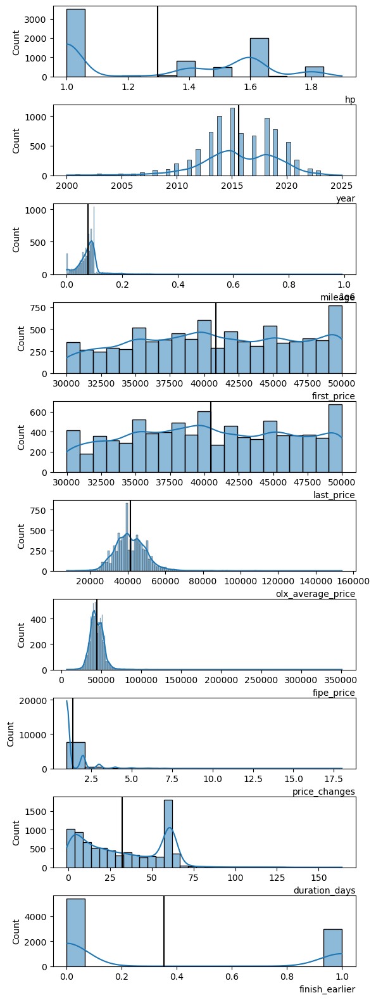

In [41]:
imprimir_histogramas_de_features_numericas(df_original)

In [42]:
df_preproc = df_original.copy()

In [43]:
df_original.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8335 entries, 0 to 8334
Data columns (total 28 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   creation_date         8335 non-null   datetime64[ns]
 1   last_update_date      8335 non-null   datetime64[ns]
 2   creation_week_day     8335 non-null   object        
 3   last_update_week_day  8335 non-null   object        
 4   latitude              8335 non-null   float64       
 5   longitude             8335 non-null   float64       
 6   city                  8335 non-null   object        
 7   hp                    7459 non-null   float64       
 8   gnv                   8335 non-null   int64         
 9   year                  8335 non-null   int64         
 10  mileage               8335 non-null   float64       
 11  doors                 8151 non-null   float64       
 12  model                 8335 non-null   object        
 13  brand             

### 3.2. Criação do dataset, aplicando o pré-processamento

In [44]:
df_preproc\
  .pipe(preencher_dados_faltantes)\
  .pipe(separar_acessorios_em_colunas)\
  .pipe(substituir_outliers)\
  .pipe(one_hot_encoding, excluded_cols=['creation_week_day', 'last_update_week_day', 'accessories'])

,creation_date,last_update_date,creation_week_day,last_update_week_day,latitude,longitude,hp,gnv,year,mileage,...,Câmera de ré,Navegador GPS,Som,Conexão USB,Blindado,Sensor de ré,Air bag,Volante multifuncional,Controle automático de velocidade,Vidro elétrico
0,2024-03-15 21:15:00,2024-08-27 21:06:16,sexta,terça,-22.7993,-43.3650,1.000000,0,2021.0,39455.0,...,False,False,True,False,False,False,False,False,False,True
1,2024-04-16 06:12:00,2024-06-18 23:10:40,terça,terça,-23.0171,-43.4610,1.500000,0,2018.0,80826.0,...,False,False,False,False,False,False,False,False,False,True
2,2024-04-16 08:43:00,2024-06-18 23:10:39,terça,terça,-22.3822,-43.1591,1.600000,0,2011.0,98180.0,...,False,False,True,False,False,False,False,False,False,True
3,2024-04-16 10:14:00,2024-06-18 23:10:39,terça,terça,-22.8692,-43.3061,1.600000,0,2014.0,80000.0,...,False,False,True,False,False,True,False,False,False,True
4,2024-04-16 10:24:00,2024-06-18 23:10:39,terça,terça,-22.8701,-42.5616,1.500000,0,2013.0,97000.0,...,False,False,True,True,False,True,False,False,False,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8330,2024-08-27 18:54:00,2024-08-27 19:43:35,terça,terça,-22.7415,-43.4316,1.000000,0,2018.0,91000.0,...,True,True,True,True,False,False,False,False,False,True
8331,2024-08-27 19:01:00,2024-08-27 19:43:35,terça,terça,-22.4996,-43.1580,1.600000,0,2013.0,49000.0,...,False,False,True,True,False,True,False,True,True,True
8332,2024-08-27 19:08:00,2024-08-27 19:43:35,terça,terça,-22.6164,-43.2370,1.600000,0,2015.0,56000.0,...,True,True,True,True,False,True,False,False,False,True
8333,2024-08-27 19:11:00,2024-08-27 19:43:35,terça,terça,-22.7538,-42.8770,1.000000,0,2020.0,50600.0,...,False,False,True,True,False,False,False,False,False,True


In [45]:
# Remover colunas não utilizadas para o processamento
columns_to_drop = ['creation_date', 'last_update_date',
                   'creation_week_day', 'last_update_week_day', 'duration_days', 'closed']
df_preproc.drop(columns=columns_to_drop, inplace=True)
df_preproc.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8335 entries, 0 to 8334
Data columns (total 30 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   latitude                           8335 non-null   float64
 1   longitude                          8335 non-null   float64
 2   hp                                 8335 non-null   float64
 3   gnv                                8335 non-null   int64  
 4   year                               8335 non-null   float64
 5   mileage                            8335 non-null   float64
 6   doors                              8335 non-null   float64
 7   first_price                        8335 non-null   float64
 8   last_price                         8335 non-null   float64
 9   olx_average_price                  8335 non-null   float64
 10  fipe_price                         8335 non-null   float64
 11  price_changes                      8335 non-null   float

In [46]:
[col for col in df_preproc.columns]

['latitude',
 'longitude',
 'hp',
 'gnv',
 'year',
 'mileage',
 'doors',
 'first_price',
 'last_price',
 'olx_average_price',
 'fipe_price',
 'price_changes',
 'finish_earlier',
 'Trava elétrica',
 'Rodas de liga leve',
 'Bancos de couro',
 'Ar condicionado',
 'Alarme',
 'Computador de bordo',
 'Interface bluetooth',
 'Câmera de ré',
 'Navegador GPS',
 'Som',
 'Conexão USB',
 'Blindado',
 'Sensor de ré',
 'Air bag',
 'Volante multifuncional',
 'Controle automático de velocidade',
 'Vidro elétrico']

### 3.3. Distribuição dos dados numéricos após o tratamento de outliers

/home/mallah/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/mallah/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/mallah/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/mallah/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Conver

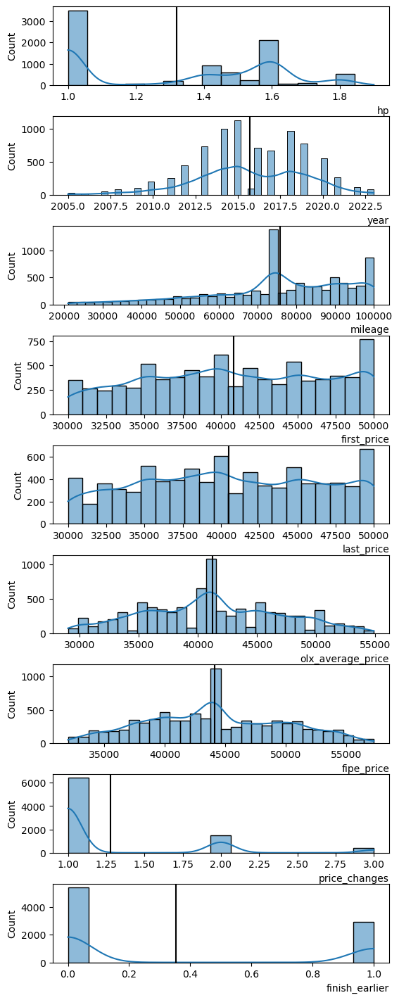

In [47]:
imprimir_histogramas_de_features_numericas(df_preproc)

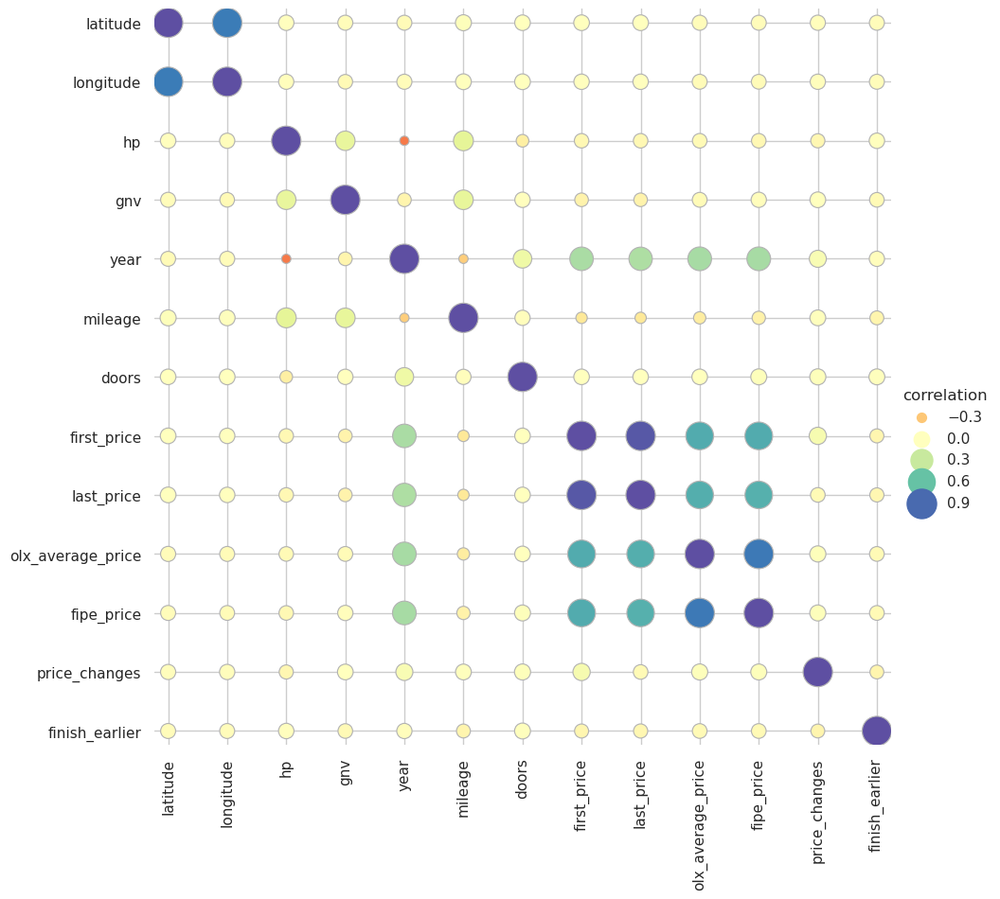

In [48]:
matriz_correlacao(df_preproc, excluded_cols=colunas_nao_numericas(df_preproc))

## 4. Treinamento não supervisionado

### 4.1. Comparação entre modelos

In [49]:
# Separando dados para treino e teste

# Definição de features (X) e target (y)
X = df_preproc.drop(columns=['finish_earlier'])
y = df_preproc['finish_earlier']

# Seperação do dataset em dados de treinamento e teste
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

X_train.shape, X_test.shape, y_train.shape, y_test.shape


((5834, 29), (2501, 29), (5834,), (2501,))

In [50]:
# Treinar os modelos

logistic_regression_model = LogisticRegression(max_iter=1000, random_state=42)
svm_model = SVC(random_state=42, probability=True)
gradient_boosting_model = GradientBoostingClassifier(random_state=42)

models = {
    "Logistic Regression": logistic_regression_model,
    "Support Vector Machine": svm_model,
    "Gradient Boosting": gradient_boosting_model
}

results = {}

for model_name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    report = classification_report(y_test, y_pred, output_dict=True)
    report_df = pd.DataFrame(report).transpose()
    results[model_name] = {
        "accuracy": accuracy,
        "report": report_df
    }


/home/mallah/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/mallah/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/mallah/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [51]:
# Exibir o resultado dos treinamentos

exibir_resultado_modelos(results)

### Logistic Regression ###
Accuracy: 0.65


,precision,recall,f1-score,support
0,0.653970,0.998775,0.790405,1633.000000
1,0.714286,0.005760,0.011429,868.000000
accuracy,0.654138,0.654138,0.654138,0.654138
macro avg,0.684128,0.502268,0.400917,2501.000000
weighted avg,0.674903,0.654138,0.520052,2501.000000




### Support Vector Machine ###
Accuracy: 0.65


,precision,recall,f1-score,support
0,0.652939,1.000000,0.790034,1633.000000
1,0.000000,0.000000,0.000000,868.000000
accuracy,0.652939,0.652939,0.652939,0.652939
macro avg,0.326469,0.500000,0.395017,2501.000000
weighted avg,0.426329,0.652939,0.515844,2501.000000




### Gradient Boosting ###
Accuracy: 0.65


,precision,recall,f1-score,support
0,0.669008,0.933252,0.779340,1633.000000
1,0.511211,0.131336,0.208983,868.000000
accuracy,0.654938,0.654938,0.654938,0.654938
macro avg,0.590109,0.532294,0.494161,2501.000000
weighted avg,0.614243,0.654938,0.581391,2501.000000


### 4.2. Importância de cada feature para o modelo GBM

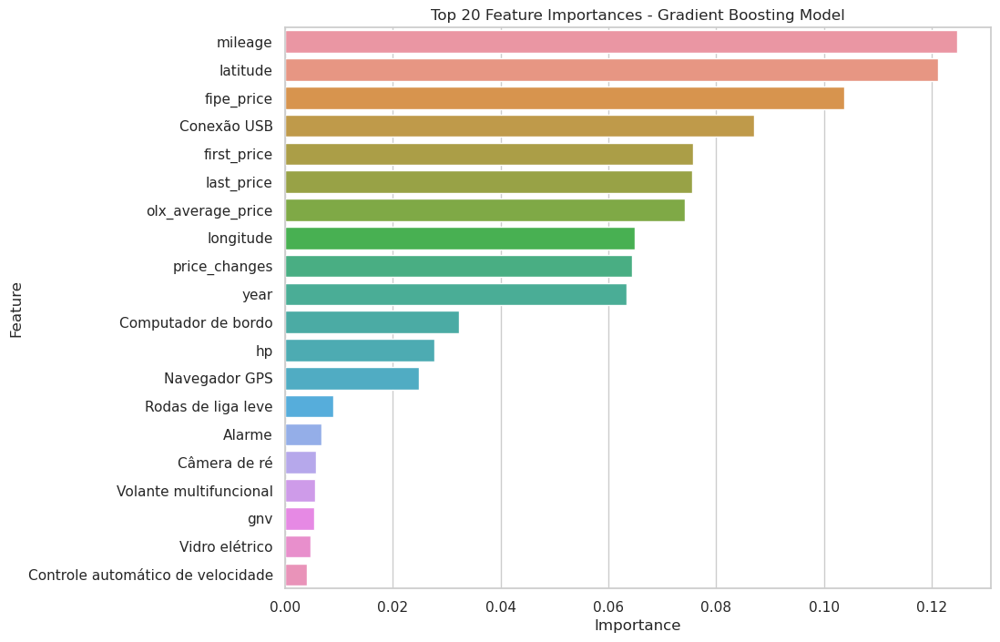

In [52]:
# Listar a importância de cada feature para o modelo GBM

feature_importances = gradient_boosting_model.feature_importances_
features = X_train.columns

importance_df = pd.DataFrame({
    'Feature': features,
    'Importance': feature_importances
})

# Ordenar por importância
importance_df = importance_df.sort_values(by='Importance', ascending=False).head(20)  # Display top 20 features

# Exibir o gráfico dos resultados
plt.figure(figsize=(10, 8))
sns.barplot(x='Importance', y='Feature', data=importance_df)
plt.title('Top 20 Feature Importances - Gradient Boosting Model')
plt.show()


### 4.3. Modelo Ensemble

In [53]:
# Usando modelo ensamble

from sklearn.ensemble import VotingClassifier

# Combine models using VotingClassifier
voting_clf = VotingClassifier(estimators=[
    ('lr', logistic_regression_model),
    ('svm', svm_model),
    ('gb', gradient_boosting_model)
], voting='soft')

# Train and evaluate the ensemble model
voting_clf.fit(X_train, y_train)
y_pred = voting_clf.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
report = classification_report(y_test, y_pred, output_dict=True)
ensemble_report_df = pd.DataFrame(report).transpose()

ensemble_results = {
    "accuracy": accuracy,
    "report": ensemble_report_df
}

In [54]:
# Exibir o resultado dos treinamentos

# Display the classification reports
print("### Baseline Models ###")
for model_name, result in results.items():
    print(f"### {model_name} ###")
    print(f"Accuracy: {result['accuracy']:.2f}")
    display(result['report'])
    print("\\n")

print("### Ensemble Model ###")
print(f"Accuracy: {ensemble_results['accuracy']:.2f}")
display(ensemble_results['report'])

### Baseline Models ###
### Logistic Regression ###
Accuracy: 0.65


,precision,recall,f1-score,support
0,0.653970,0.998775,0.790405,1633.000000
1,0.714286,0.005760,0.011429,868.000000
accuracy,0.654138,0.654138,0.654138,0.654138
macro avg,0.684128,0.502268,0.400917,2501.000000
weighted avg,0.674903,0.654138,0.520052,2501.000000


\n
### Support Vector Machine ###
Accuracy: 0.65


,precision,recall,f1-score,support
0,0.652939,1.000000,0.790034,1633.000000
1,0.000000,0.000000,0.000000,868.000000
accuracy,0.652939,0.652939,0.652939,0.652939
macro avg,0.326469,0.500000,0.395017,2501.000000
weighted avg,0.426329,0.652939,0.515844,2501.000000


\n
### Gradient Boosting ###
Accuracy: 0.65


,precision,recall,f1-score,support
0,0.669008,0.933252,0.779340,1633.000000
1,0.511211,0.131336,0.208983,868.000000
accuracy,0.654938,0.654938,0.654938,0.654938
macro avg,0.590109,0.532294,0.494161,2501.000000
weighted avg,0.614243,0.654938,0.581391,2501.000000


\n
### Ensemble Model ###
Accuracy: 0.65


,precision,recall,f1-score,support
0,0.654450,0.995101,0.789602,1633.000000
1,0.555556,0.011521,0.022573,868.000000
accuracy,0.653739,0.653739,0.653739,0.653739
macro avg,0.605003,0.503311,0.406087,2501.000000
weighted avg,0.620128,0.653739,0.523396,2501.000000


### 4.4. Modelo de predição de classes

In [55]:
# Criar modelo de predição baseado em classes

data = df_original.copy()

# Create the `duration` feature
data['duration'] = (data['last_update_date'] - data['creation_date']).dt.days

# Create the `closed` feature
data['closed'] = data['duration'] > 0

# Determine the optimal bin size for `duration_class`
# Using the Freedman-Diaconis rule for bin width
q75, q25 = np.percentile(data['duration'], [75 ,25])
iqr = q75 - q25
bin_width = 2 * iqr * (len(data['duration']) ** (-1/3))
bins = int((data['duration'].max() - data['duration'].min()) / bin_width)

# Create the `duration_class` feature by binning the `duration`
data['duration_class'] = pd.cut(data['duration'], bins=bins, right=False)

# Drop rows with NaN values in `duration_class`
data = data.dropna(subset=['duration_class'])

# Convert `duration_class` to a categorical integer encoding for modeling
data['duration_class_encoded'] = data['duration_class'].cat.codes

# Remove features that might introduce bias
features_to_remove = [
    'creation_date', 'last_update_date', 'duration', 'closed', 'duration_class',
    'duration_class_encoded', 'first_price', 'last_price']
features = data.drop(columns=features_to_remove)

# Handle missing values by filling with mean for numerical features and mode for categorical features
features = features.apply(lambda col: col.fillna(col.mean()) if col.dtype.kind in 'biufc' else col.fillna(col.mode()[0]))

# Convert categorical variables to dummy/indicator variables
features = pd.get_dummies(features)

# Prepare the target variable
y = data['duration_class_encoded']

# Scale the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(features)

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.3, random_state=42)

# Train a Random Forest Classifier
rf_model = RandomForestClassifier(random_state=42)
rf_model.fit(X_train, y_train)

# Predict on the test set
y_pred = rf_model.predict(X_test)

In [56]:
# Exibir performance do modelo

accuracy = accuracy_score(y_test, y_pred)
report = classification_report(y_test, y_pred, output_dict=True)

model = {
    'Random forest': {
        'accuracy': accuracy,
        'report': pd.DataFrame(report).transpose()
    }
  }

exibir_resultado_modelos(model)

### Random forest ###
Accuracy: 0.58


/home/mallah/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/mallah/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/mallah/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
0,0.755051,0.990066,0.856734,302.00000
1,0.514523,0.939394,0.664879,264.00000
2,0.443902,0.481481,0.461929,189.00000
3,0.347222,0.153374,0.212766,163.00000
4,0.339806,0.241379,0.282258,145.00000
5,0.326087,0.114504,0.169492,131.00000
6,0.360000,0.140625,0.202247,128.00000
7,0.340909,0.254237,0.291262,118.00000
8,0.387755,0.195876,0.260274,97.00000
9,0.200000,0.048780,0.078431,82.00000


## 5. Analise dos dados

In [57]:
# Gerar o conjunto de dados para analises

df_analise = df_original.copy()

df_analise\
  .pipe(calcular_duracao_anuncio)\
  .pipe(categorizar_coluna_numerica, 'mileage', 10)
df_analise.head(5)

,creation_date,last_update_date,creation_week_day,last_update_week_day,latitude,longitude,city,hp,gnv,year,...,first_price,last_price,olx_average_price,fipe_price,price_changes,accessories,closed,duration_days,finish_earlier,mileage_tip
0,2024-03-15 21:15:00,2024-08-27 21:06:16,sexta,terça,-22.7993,-43.3650,São João de Meriti,1.0,0,2021,...,46900.0,46900.0,45900.0,48691.0,1,"Air bag, Alarme, Ar condicionado, Som, Trava e...",False,164,0,NaN
1,2024-04-16 06:12:00,2024-06-18 23:10:40,terça,terça,-23.0171,-43.4610,Rio de Janeiro,1.5,0,2018,...,43500.0,43500.0,41500.0,43688.0,1,"Air bag, Ar condicionado, Trava elétrica, Vidr...",True,63,0,NaN
2,2024-04-16 08:43:00,2024-06-18 23:10:39,terça,terça,-22.3822,-43.1591,Petrópolis,1.6,0,2011,...,30500.0,30500.0,25000.0,27787.0,1,"Alarme, Ar condicionado, Som, Trava elétrica, ...",True,63,0,NaN
3,2024-04-16 10:14:00,2024-06-18 23:10:39,terça,terça,-22.8692,-43.3061,Rio de Janeiro,1.6,0,2014,...,46800.0,46800.0,43900.0,46948.0,1,"Air bag, Alarme, Ar condicionado, Sensor de ré...",True,63,0,NaN
4,2024-04-16 10:24:00,2024-06-18 23:10:39,terça,terça,-22.8701,-42.5616,Saquarema,1.5,0,2013,...,33900.0,33900.0,30000.0,34909.0,1,"Air bag, Ar condicionado, Computador de bordo,...",True,63,0,NaN


### 5.1. Analise de preço

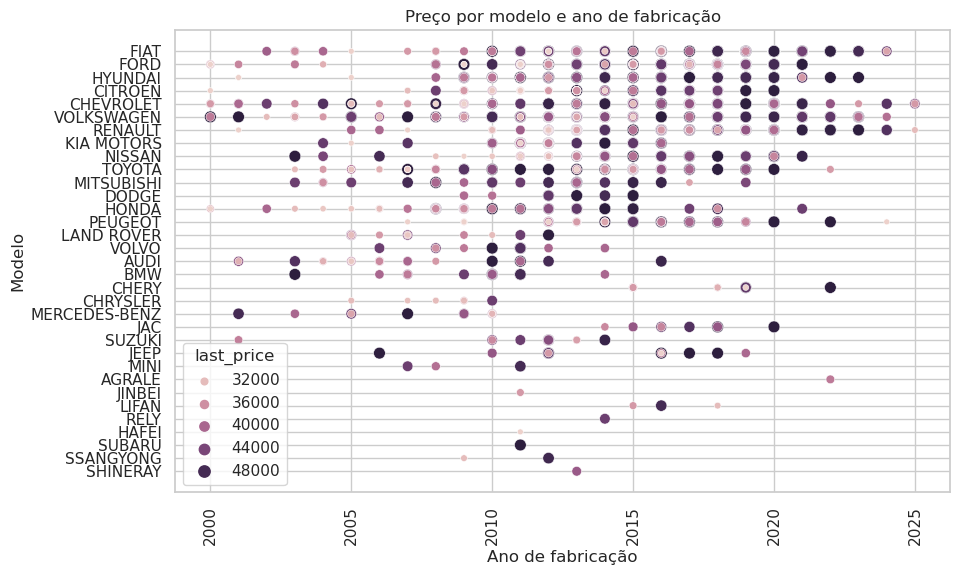

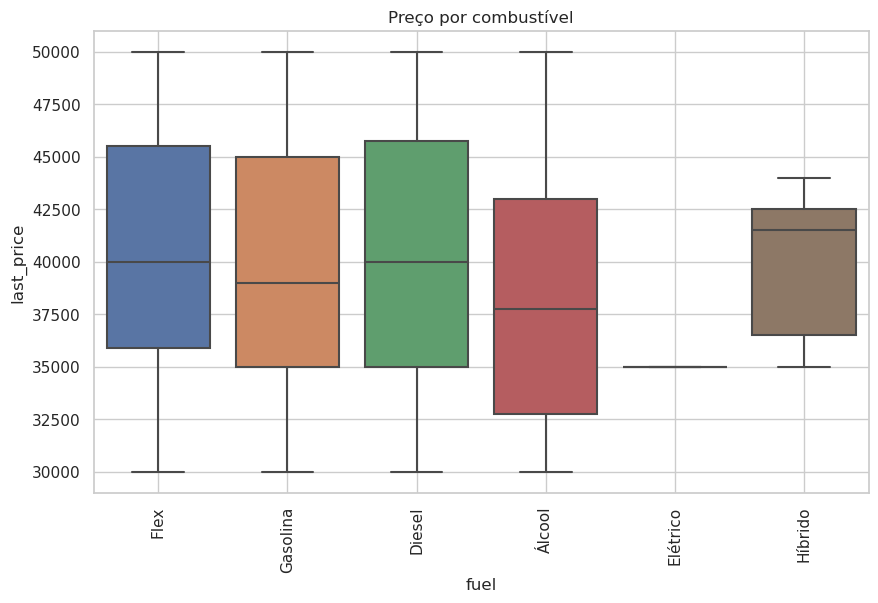

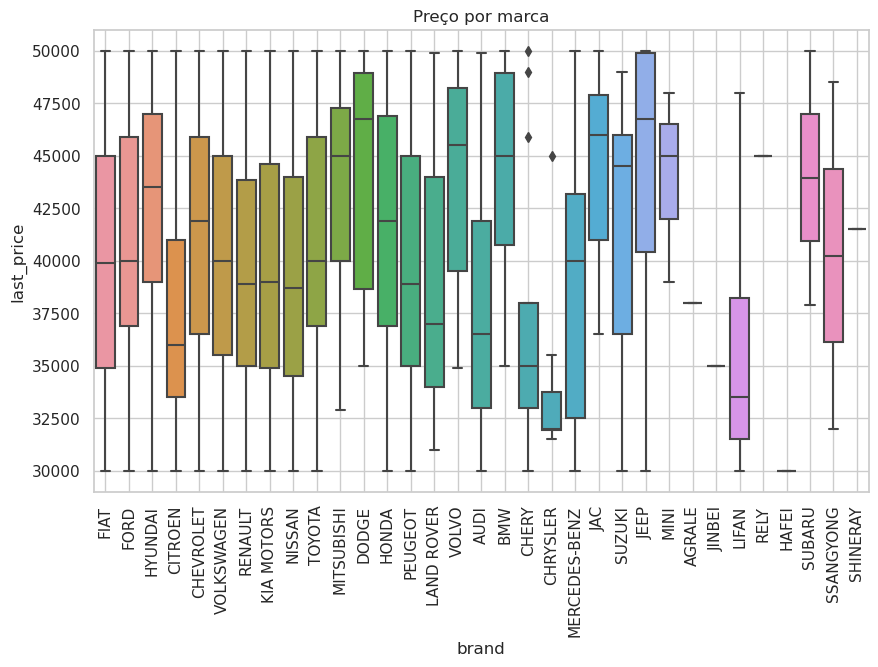

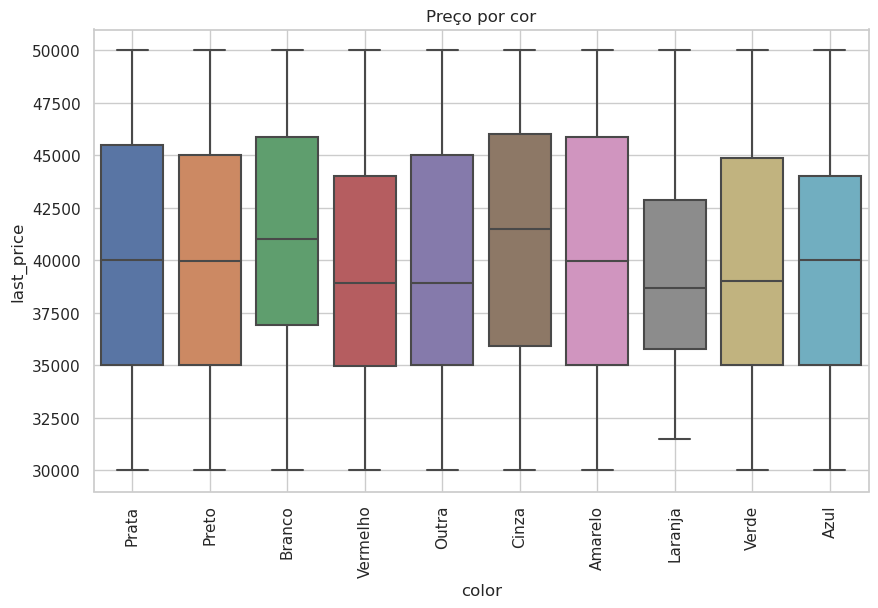

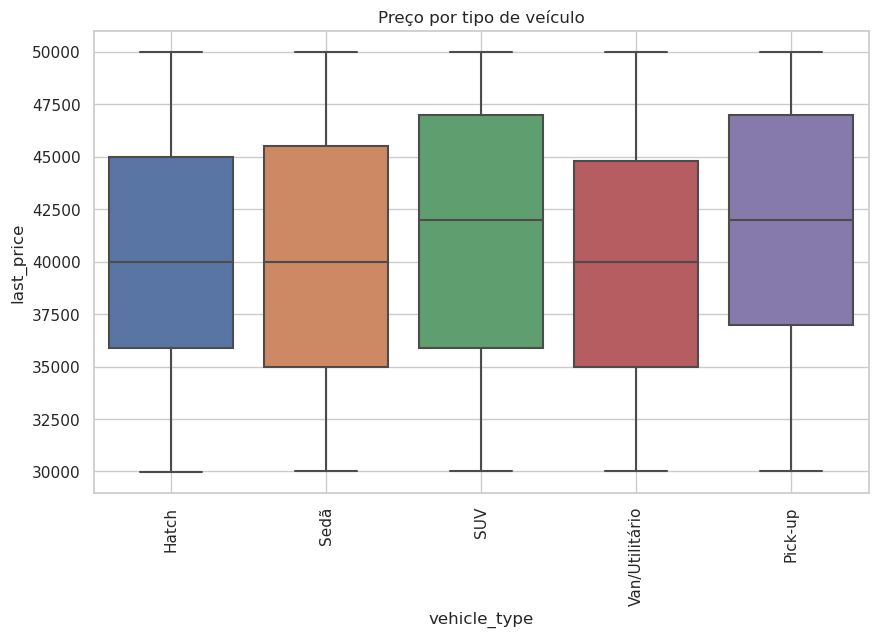

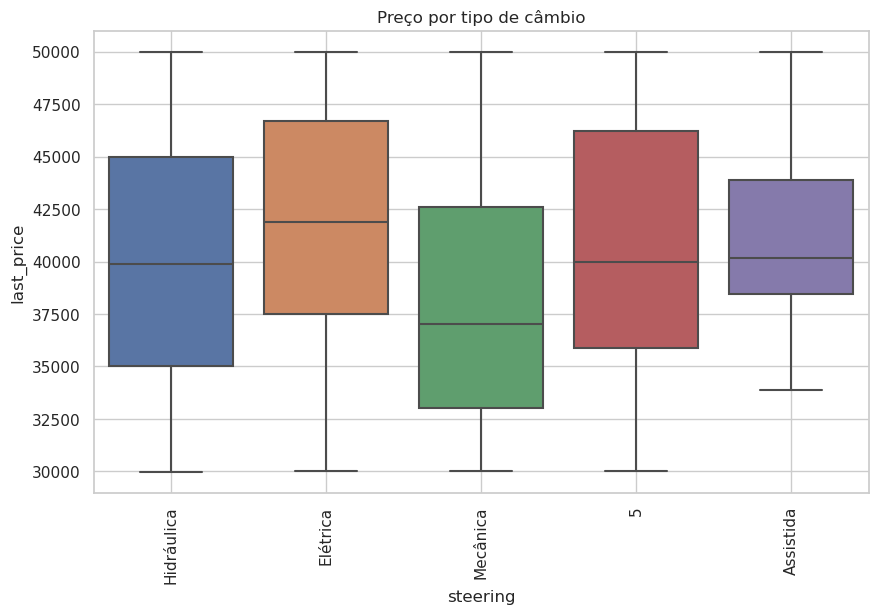

/tmp/ipykernel_67434/1184865572.py:24: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df=df_analise.groupby(by=['mileage_tip'])[['last_price', 'olx_average_price', 'fipe_price']].mean(),


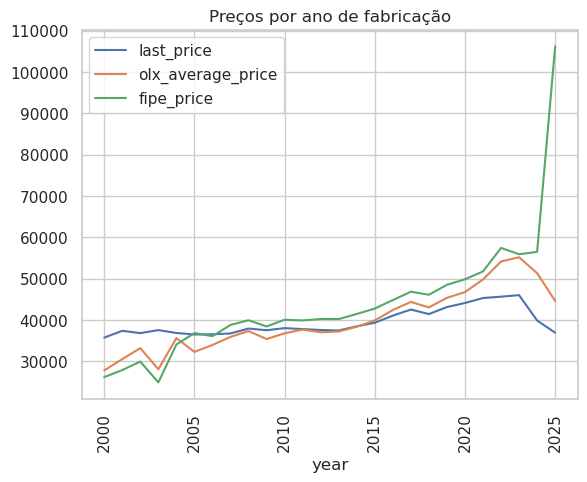

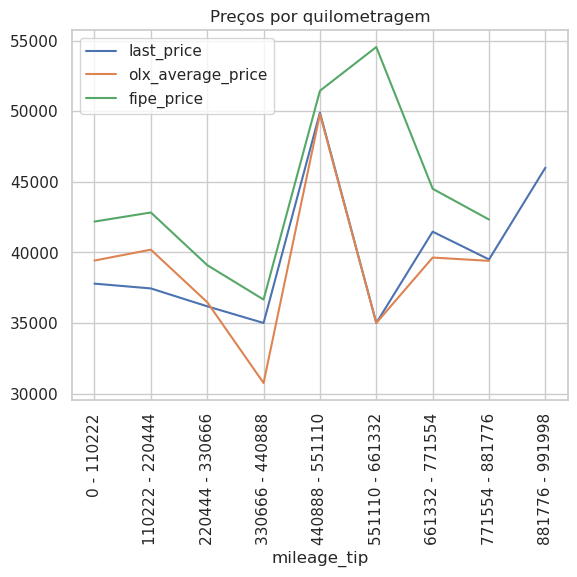

In [58]:
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.ticker import MultipleLocator

fig = plt.figure(figsize=(10, 6))
sns.scatterplot(data=df_analise, x='year', y='brand', hue='last_price', size='last_price')
plt.title('Preço por modelo e ano de fabricação')
plt.xlabel('Ano de fabricação')
plt.ylabel('Modelo')
plt.xticks(rotation=90)
plt.show()

imprimir_boxplot(df_analise, 'fuel', 'last_price', 'Preço por combustível')
#imprimir_histograma(df_analise, 'year', 'Distribuição de anuncios por ano de fabricação')
imprimir_boxplot(df_analise, 'brand', 'last_price', 'Preço por marca')
imprimir_boxplot(df_analise, 'color', 'last_price', 'Preço por cor')
imprimir_boxplot(df_analise, 'vehicle_type', 'last_price', 'Preço por tipo de veículo')
imprimir_boxplot(df_analise, 'steering', 'last_price', 'Preço por tipo de câmbio')
imprimir_linhas(
    df=df_original.groupby(by=['year'])[['last_price', 'olx_average_price', 'fipe_price']].mean(),
    features=['last_price', 'olx_average_price', 'fipe_price'],
    title='Preços por ano de fabricação')
imprimir_linhas(
    df=df_analise.groupby(by=['mileage_tip'])[['last_price', 'olx_average_price', 'fipe_price']].mean(),
    features=['last_price', 'olx_average_price', 'fipe_price'],
    title='Preços por quilometragem')

### 5.2. Análise geográfica

In [59]:
# Import necessary libraries
import pandas as pd
import folium
from folium.plugins import MarkerCluster

# Load the dataset
df = df_original.copy()

# Display the first few rows of the dataset
df.head()

# Handle missing values (if any)
df = df.dropna(subset=['latitude', 'longitude'])

# Convert appropriate columns to their correct data types
df['creation_date'] = pd.to_datetime(df['creation_date'])
df['last_update_date'] = pd.to_datetime(df['last_update_date'])

# Create a map centered around the mean latitude and longitude
map_center = [df['latitude'].mean(), df['longitude'].mean()]
car_map = folium.Map(location=map_center, zoom_start=12)

# Add a marker cluster to the map
marker_cluster = MarkerCluster().add_to(car_map)

# Add markers to the map
for idx, row in df.iterrows():
    folium.Marker(
        location=[row['latitude'], row['longitude']],
        popup=(
            f"ID: {idx}<br>"
            f"City: {row['city']}<br>"
            f"Brand: {row['brand']}<br>"
            f"Model: {row['model']}<br>"
            f"Year: {row['year']}<br>"
            f"Price: {row['last_price']}"
        )
    ).add_to(marker_cluster)

# Save the map to an HTML file
car_map.save('car_announcements_map.html')

# Display the map in the notebook
car_map


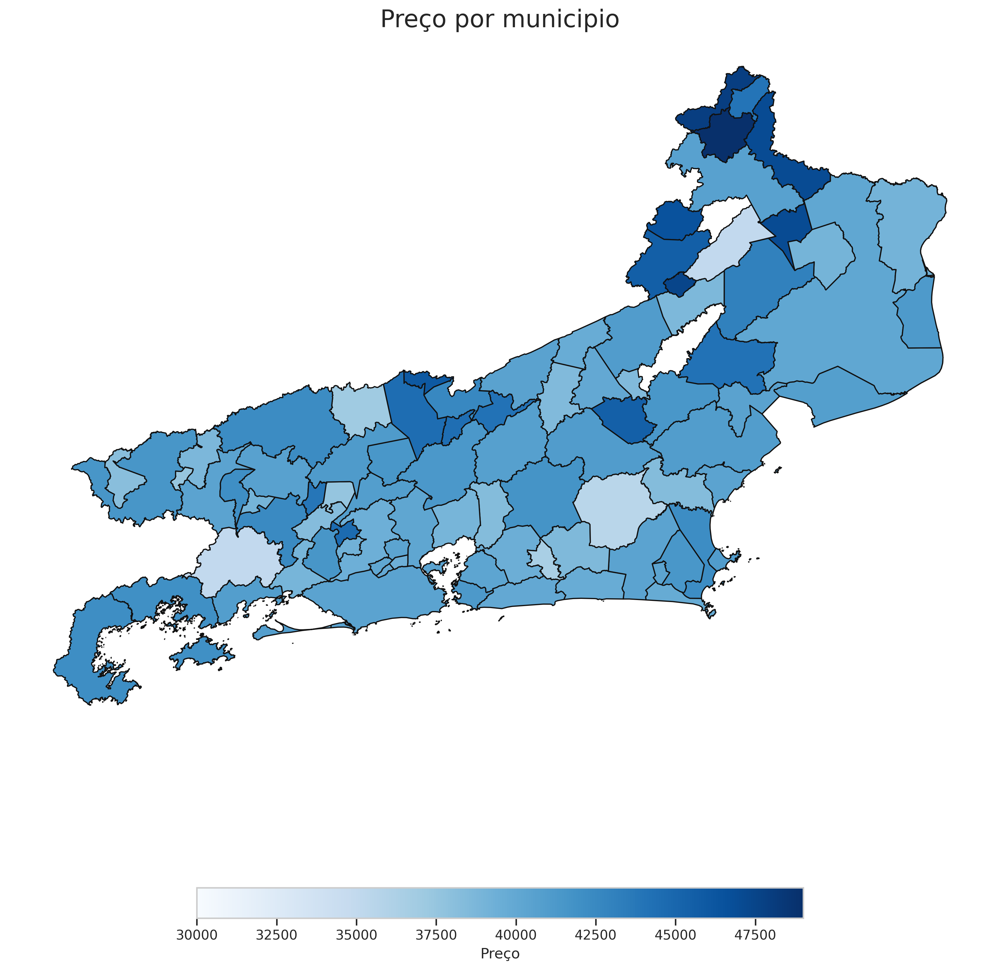

In [60]:
imprimir_mapa(df=df_original,
    column='last_price',
    title='Preço por municipio',
    label='Preço')

In [61]:
df = df_original[['latitude', 'longitude', 'last_price', 'olx_average_price', 'fipe_price']].copy()

df['diff_olx_price'] = ((df_original['last_price'] - df_original['olx_average_price']) / df_original['last_price'])
df['diff_olx_price'] = pd.cut(df['diff_olx_price'], bins=[float('-inf'), -.2, 0, .2, float('inf')], labels=['muito barato', 'barato', 'caro', 'muito caro'])

df['diff_fipe_price'] = ((df_original['last_price'] - df_original['fipe_price']) / df_original['last_price'])
df['diff_fipe_price'] = pd.cut(df['diff_fipe_price'], bins=[float('-inf'), -.2, 0, .2, float('inf')], labels=['muito barato', 'barato', 'caro', 'muito caro'])

gdf = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df.longitude, df.latitude), crs="EPSG:4326")
gdf.drop(columns=['latitude', 'longitude', 'last_price', 'olx_average_price', 'fipe_price'], inplace=True)
gdf.dropna(axis=0, inplace=True)

In [62]:
# carregar dataset de municipios do Rio
df_geojson = gpd.read_file('./geojs-33-mun.json')

# preparar dataset de anúncios para exibição no mapa
df_map = df_original.copy()
df_map['city'] = df_map['city'].apply(lambda city : formatar_municipio(city))
groupby = df_map.groupby(by='city')
df_map = pd.DataFrame({
    'avg_price': groupby['last_price'].mean(),
    'avg_olx_price': groupby['olx_average_price'].mean(),
    'avg_fipe_price': groupby['fipe_price'].mean(),
    'count': groupby['creation_date'].count(),
    'ln_count': np.log(groupby['creation_date'].count())
}).reset_index()

# remoção de municipios que não contẽm dados
df_aux = df_geojson.merge(df_map, how='left', left_on='name', right_on='city')
to_delete = df_aux[df_aux['avg_price'].isna() | df_aux['avg_olx_price'].isna() | df_aux['avg_fipe_price'].isna() | df_aux['count'].isna()]['name']
df_geojson = df_geojson.loc[(~df_geojson['name'].isin(to_delete))].reset_index()

imprimir_mapa_interativo(df=df_map, state_geo=df_geojson, gdf=gdf, title='Titulo')

### 5.3. Analise de características diversas do dataset

In [63]:
df_created = contar_dias_da_semana(df_original, 'creation_week_day')
df_created['anuncio'] = 'criado'
df_closed = contar_dias_da_semana(df_original[df_original['closed'] == True], 'last_update_week_day')
df_closed['anuncio'] = 'fechado'
df = pd.concat([df_created, df_closed]).reset_index()

[Text(0.5, 0, 'dias da semana'),
 Text(0, 0.5, 'número de anúncios'),
 Text(0.5, 1.0, 'Número de anuncios criados e fechados por dia de semana')]

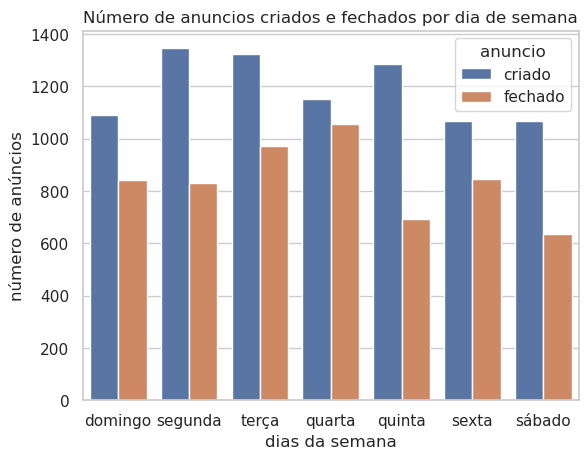

In [64]:
# Número de anuncios criados e fechados por dia de semana
g = sns.barplot(df,
            x='index',
            y='creation_date',
            hue='anuncio')
g.set(
    xlabel='dias da semana',
    ylabel='número de anúncios',
    title='Número de anuncios criados e fechados por dia de semana')

In [65]:
df_duration = df_original.copy()
df_duration.pipe(calcular_duracao_anuncio)
df_duration.head(5)

,creation_date,last_update_date,creation_week_day,last_update_week_day,latitude,longitude,city,hp,gnv,year,...,steering,first_price,last_price,olx_average_price,fipe_price,price_changes,accessories,closed,duration_days,finish_earlier
0,2024-03-15 21:15:00,2024-08-27 21:06:16,sexta,terça,-22.7993,-43.3650,São João de Meriti,1.0,0,2021,...,Hidráulica,46900.0,46900.0,45900.0,48691.0,1,"Air bag, Alarme, Ar condicionado, Som, Trava e...",False,164,0
1,2024-04-16 06:12:00,2024-06-18 23:10:40,terça,terça,-23.0171,-43.4610,Rio de Janeiro,1.5,0,2018,...,Elétrica,43500.0,43500.0,41500.0,43688.0,1,"Air bag, Ar condicionado, Trava elétrica, Vidr...",True,63,0
2,2024-04-16 08:43:00,2024-06-18 23:10:39,terça,terça,-22.3822,-43.1591,Petrópolis,1.6,0,2011,...,Mecânica,30500.0,30500.0,25000.0,27787.0,1,"Alarme, Ar condicionado, Som, Trava elétrica, ...",True,63,0
3,2024-04-16 10:14:00,2024-06-18 23:10:39,terça,terça,-22.8692,-43.3061,Rio de Janeiro,1.6,0,2014,...,Hidráulica,46800.0,46800.0,43900.0,46948.0,1,"Air bag, Alarme, Ar condicionado, Sensor de ré...",True,63,0
4,2024-04-16 10:24:00,2024-06-18 23:10:39,terça,terça,-22.8701,-42.5616,Saquarema,1.5,0,2013,...,Elétrica,33900.0,33900.0,30000.0,34909.0,1,"Air bag, Ar condicionado, Computador de bordo,...",True,63,0


In [66]:
group = df_duration.groupby(by=['model','year'])['duration_days'].aggregate(['count', 'mean']).sort_values(by='count', ascending=False)
group.rename(columns={'count':'N° de anúncios', 'mean': 'Duração média em dias'}, inplace=True)
group.head(10)

N° de anúncios  \
model                                          year                   
FORD KA 1.0 SE/SE PLUS TIVCT FLEX 5P           2018             120   
                                               2019              96   
                                               2020              92   
                                               2015              58   
HYUNDAI HB20 COMF./C.PLUS/C.STYLE 1.0 FLEX 12V 2015              58   
CHEVROLET JOY HATCH 1.0 8V FLEX MEC. 4P        2018              48   
RENAULT KWID ZEN 1.0 FLEX 12V 5P MEC.          2018              46   
                                               2020              43   
FIAT MOBI LIKE 1.0 FIRE FLEX 5P.               2021              40   
RENAULT KWID ZEN 1.0 FLEX 12V 5P MEC.          2019              40   

                                                     Duração média em dias  
model                                          year                         
FORD KA 1.0 SE/SE PLUS TIVCT FLEX 5P           2018              34.041667  
                                               2019              38.354167  
                                               2020              35.315217  
                                               2015              33.224138  
HYUNDAI HB20 COMF./C.PLUS/C.STYLE 1.0 FLEX 12V 2015              31.551724  
CHEVROLET JOY HATCH 1.0 8V FLEX MEC. 4P        2018              18.729167  
RENAULT KWID ZEN 1.0 FLEX 12V 5P MEC.          2018              30.413043  
                                               2020              32.720930  
FIAT MOBI LIKE 1.0 FIRE FLEX 5P.               2021              39.450000  
RENAULT KWID ZEN 1.0 FLEX 12V 5P MEC.          2019              37.200000

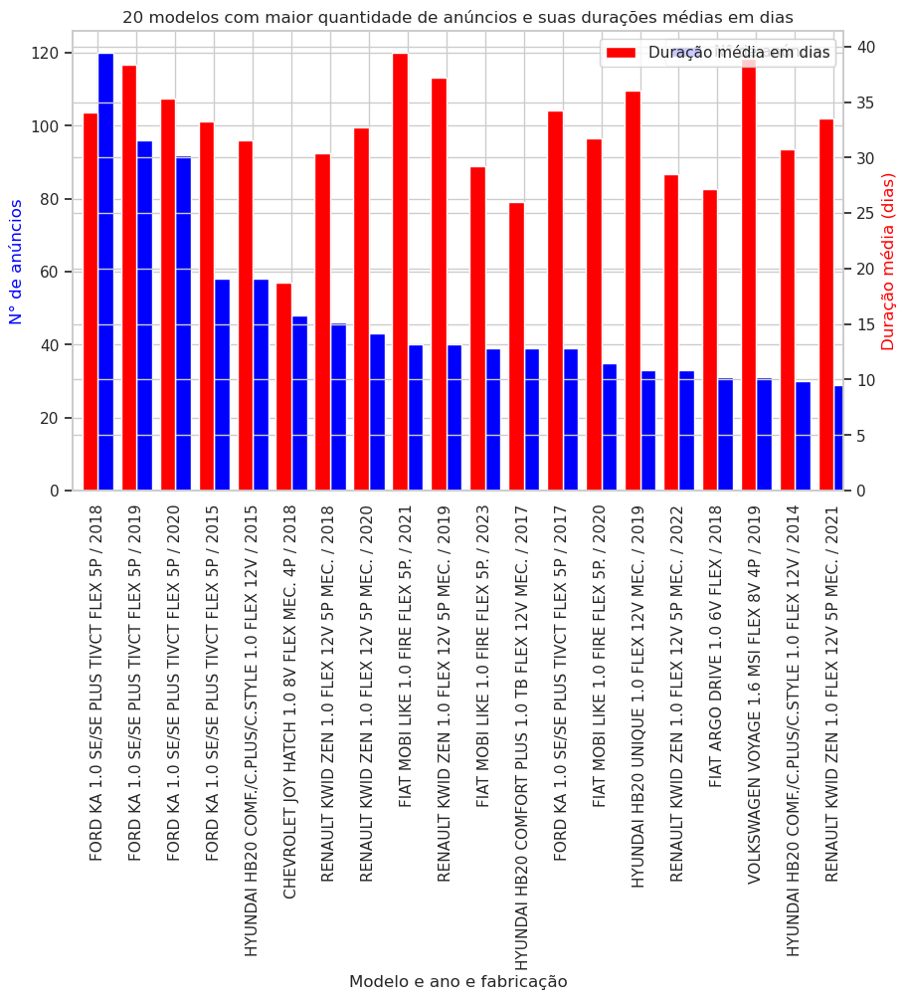

In [67]:
import pandas as pd
import matplotlib.pyplot as plt

df_plot = group.head(20).copy()

df_plot.reset_index(inplace=True)
df_plot['model_and_year'] = df_plot['model'].str.cat(df_plot['year'].astype(str), sep=' / ')

# Create a bar chart displaying the count and mean price by model and year
fig, ax1 = plt.subplots(figsize=(10, 6))

# Plot count on the left axis
df_plot.plot(kind='bar', x='model_and_year', y='N° de anúncios', ax=ax1, position=0, color='blue', width=0.4, align='center')

# Create a second y-axis to plot mean price
ax2 = ax1.twinx()
df_plot.plot(kind='bar', x='model_and_year', y='Duração média em dias', ax=ax2, position=1, color='red', width=0.4, align='center')

# Set labels and title
ax1.set_ylabel('N° de anúncios', color='blue')
ax2.set_ylabel('Duração média (dias)', color='red')
ax1.set_xlabel('Modelo e ano e fabricação')
plt.title('20 modelos com maior quantidade de anúncios e suas durações médias em dias')

# Show the chart
plt.show()


/tmp/ipykernel_67434/270653159.py:4: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  g.set_xticklabels(labels=group['brand'].unique(), rotation=90)


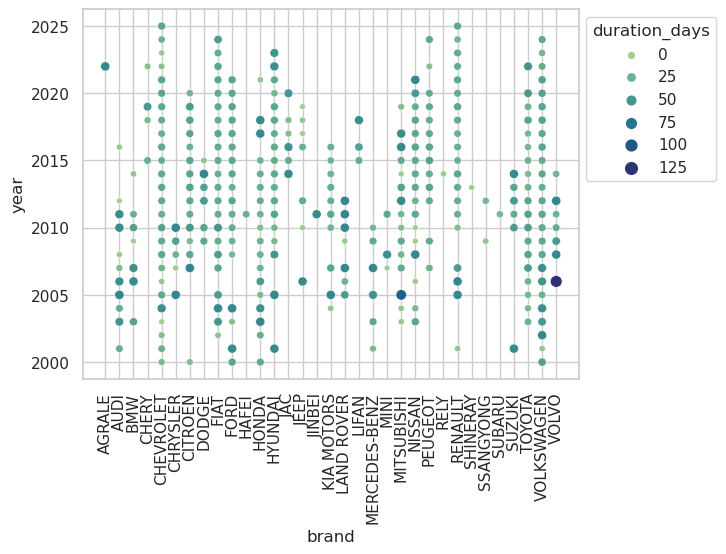

In [68]:
# duração média por marca
group = df_duration.groupby(by=['brand', 'year'])['duration_days'].mean().reset_index()
g = sns.scatterplot(data=group, x='brand', y='year', hue='duration_days', size='duration_days', palette="crest")
g.set_xticklabels(labels=group['brand'].unique(), rotation=90)
sns.move_legend(g, "upper left", bbox_to_anchor=(1, 1))

In [69]:
# 20 modelos mais anunciados por ano de fabricação
df_original.groupby(by=['model','year']).count()['creation_date'].sort_values(ascending=False).head(20)

model                                           year
FORD KA 1.0 SE/SE PLUS TIVCT FLEX 5P            2018    120
                                                2019     96
                                                2020     92
                                                2015     58
HYUNDAI HB20 COMF./C.PLUS/C.STYLE 1.0 FLEX 12V  2015     58
CHEVROLET JOY HATCH 1.0 8V FLEX MEC. 4P         2018     48
RENAULT KWID ZEN 1.0 FLEX 12V 5P MEC.           2018     46
                                                2020     43
FIAT MOBI LIKE 1.0 FIRE FLEX 5P.                2021     40
RENAULT KWID ZEN 1.0 FLEX 12V 5P MEC.           2019     40
FIAT MOBI LIKE 1.0 FIRE FLEX 5P.                2023     39
HYUNDAI HB20 COMFORT PLUS 1.0 TB FLEX 12V MEC.  2017     39
FORD KA 1.0 SE/SE PLUS TIVCT FLEX 5P            2017     39
FIAT MOBI LIKE 1.0 FIRE FLEX 5P.                2020     35
HYUNDAI HB20 UNIQUE 1.0 FLEX 12V MEC.           2019     33
RENAULT KWID ZEN 1.0 FLEX 12V 5P MEC.          